# 🚖 🧞‍♂️ RouteGenie – Intelligent Path Planning  
## 🤖🛤️🏁 Autonomous decision-making for smarter urban mobility  of Taxi/Cab
---

### 📜 Project Introduction

##### This project focuses on implementing reinforcement learning to solve the classic **Taxi-v3 problem** using **Q-learning**. The agent learns to navigate a grid environment, picking up and dropping passengers at designated locations while maximizing its reward. We enhance the model with visualizations such as heatmaps and reward tracking to monitor the agent's learning process. Advanced features like dynamic obstacles and multi-agent coordination are introduced to simulate more complex, real-world scenarios. This project provides valuable insights into decision-making and optimization in autonomous systems.

---

### 🚗 Application

##### The use case for this project lies in the development of **autonomous vehicles** or **robotic agents** that navigate environments with obstacles and changing conditions. By modeling agent behavior in a grid-based environment, this solution can be adapted to real-world applications such as **self-driving cars**, **delivery drones**, or **warehouse robots**, where efficient decision-making, obstacle avoidance, and coordination between multiple agents are critical for successful operation.

---

### 1. Import Necessary Libraries
   - Import libraries like NumPy, Gym, Matplotlib, IPython display, etc.


In [12]:
# Import necessary libraries
import numpy as np
import pandas as pd
import gymnasium as gym
import matplotlib.pyplot as plt
import seaborn as sns

### 2. Create and Initialize the Environment
   - Initialize the Gym environment (`Taxi-v3`) with the required render mode.


In [13]:
# Create the Taxi environment
env = gym.make('Taxi-v3', render_mode="rgb_array")



Note: First intsall Xvfb (X virtual framebuffer) on terminal in Linux using:

- sudo apt update
- sudo apt install xvfb -y



In [6]:
!apt-get install -y xvfb python-opengl > /dev/null 2>&1

In [7]:
!pip install gym pyvirtualdisplay > /dev/null 2>&1

### 3. Display Setup for Visualization
   - Initialize `pyvirtualdisplay` for rendering the environment in Jupyter notebooks.


In [14]:
from pyvirtualdisplay import Display

# Initialize the virtual display for rendering
d = Display()
d.start()

### 4. Run Initial Episodes for Random Actions (Exploration Phase)
   - Set up a loop for running the initial episodes with random actions to visualize the environment.


In [15]:
# Running initial episodes to visualize random actions
episodes = 10

for episode in range(1, episodes):
    state, _ = env.reset()
    done = False
    score = 0
    img = []
    while not done:
        next_state, reward, terminated, truncated, info = env.step(env.action_space.sample())
        done = terminated or truncated
        score += reward
        display.clear_output(wait=True)
        img.append(env.render())
    print(f"Episode: {episode}\nScore: {score}")


Episode: 9
Score: -731


- Animation of Exploration Phase

Animation size has reached 20980745 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


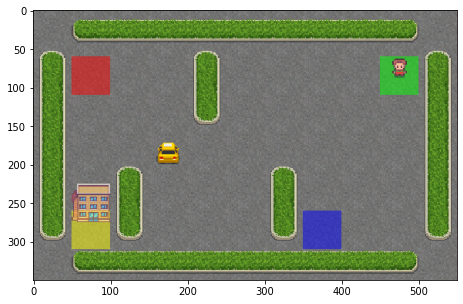

In [16]:
dpi = 72
interval = 50 # ms

plt.figure(figsize=(img[0].shape[1]/dpi,img[0].shape[0]/dpi),dpi=dpi)
patch = plt.imshow(img[0])
plt.axis=('off')
animate = lambda i: patch.set_data(img[i])
ani = animation.FuncAnimation(plt.gcf(),animate,frames=len(img),interval=interval)
display.display(display.HTML(ani.to_jshtml()))

### 5. Q-Learning Algorithm:

![Q-learning-2](Q-learning-2.jpg)


#### 5.1 Define the Action and State Spaces
   - Initialize the Q-table with zero values for actions and states.


In [17]:
# Define the action and state spaces for the Q-learning algorithm
actions = env.action_space.n
state = env.observation_space.n

# Initialize Q-table
q_table = np.zeros((state, actions))


#### 5.2 Set Hyperparameters for Q-Learning
   - Define the key parameters such as learning rate, exploration rate, discount factor, etc.


In [19]:
# Q-Learning hyperparameters
num_episodes = 10000
max_steps_per_episode = 100
learning_rate = 0.1
discount_rate = 0.99
exploration_rate = 1
max_exploration_rate = 1
min_exploration_rate = 0.01
exploration_decay_rate = 0.001


#### 5.3 Update function of the Q-Table

![Q-learning-8](Q-learning-8.jpg)


#### 5.4 Train the Agent Using Q-Learning
   - Set up the loop for running multiple episodes to train the agent. Implement Exploration vs. Exploitation logic, Q-table update, and learning.


In [36]:
# Train the agent using Q-learning
rewards_all_episodes = []
for episode in range(num_episodes):
    state, _ = env.reset()
    state = int(state)
    done = False
    rewards_cur_episode = 0

    for step in range(max_steps_per_episode):
        exploration_threshold = np.random.uniform(0, 1)
        if exploration_threshold > exploration_rate:
            action = np.argmax(q_table[state, :])  
        else:
            action = env.action_space.sample()  

        next_state, reward, terminated, truncated, info = env.step(action)
        done = terminated or truncated

        # Update Q-table
        q_table[state, action] = q_table[state, action] * (1 - learning_rate) + \
            learning_rate * (reward + discount_rate * np.max(q_table[next_state, :]))

        state = next_state
        rewards_cur_episode += reward

        if done:
            break

    exploration_rate = min_exploration_rate + (max_exploration_rate - min_exploration_rate) * np.exp(-exploration_decay_rate * episode)
    rewards_all_episodes.append(rewards_cur_episode)

print("******* Training Finished *******")

******* Training Finished *******


#### 5.5 Training Visualizations

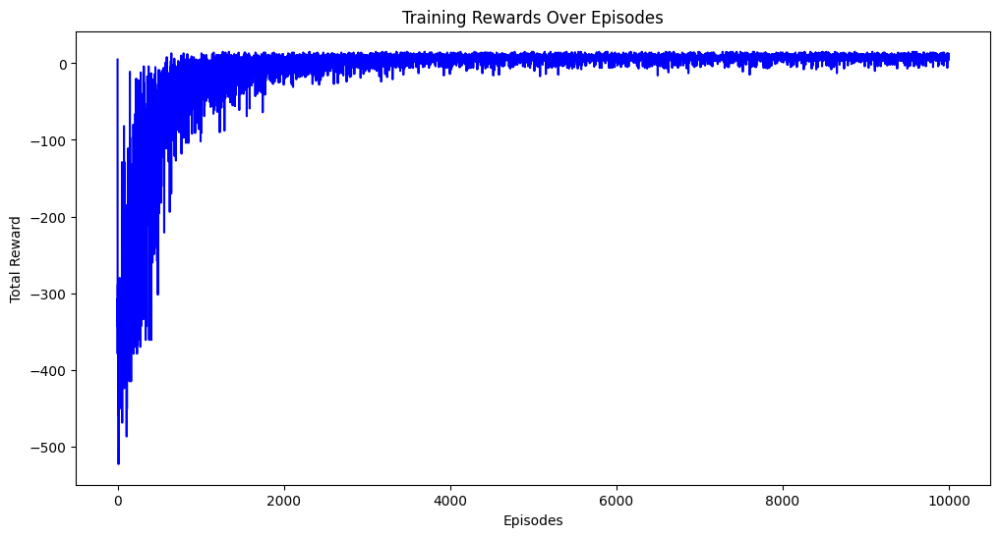

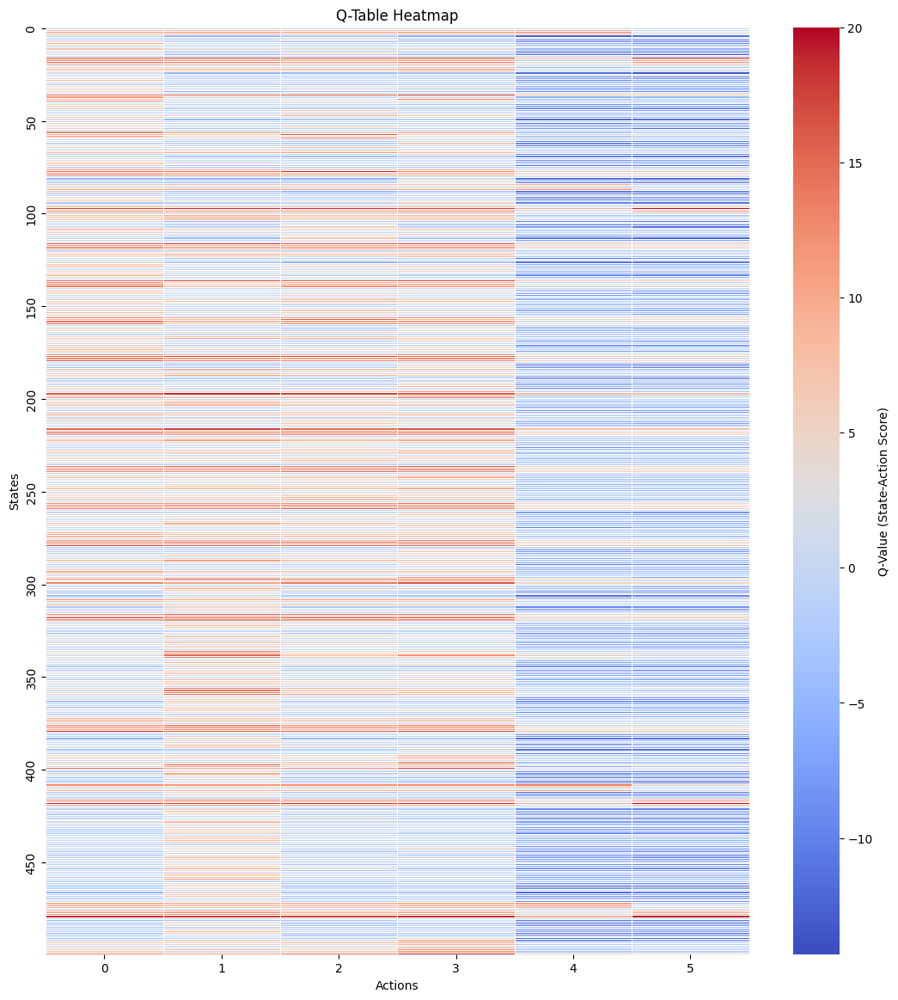

In [37]:
# ================================
# 📈 Reward History Over Episodes
# ================================
plt.figure(figsize=(12,6))
plt.plot(rewards_all_episodes, color='b')
plt.title("Training Rewards Over Episodes")
plt.xlabel("Episodes")
plt.ylabel("Total Reward")
plt.grid(False)
plt.show()


plt.figure(figsize=(13.2, 14))  # Increase figure size

# Round values for clarity
q_table_rounded = np.round(q_table, decimals=1)

# Reduce clutter: show labels every 50th row & column
sns.heatmap(q_table_rounded, annot=False, cmap="coolwarm", fmt=".1f",
            linewidths=0.5, cbar=True, xticklabels=1, yticklabels=50,
            cbar_kws={'label': 'Q-Value (State-Action Score)'})

plt.title("Q-Table Heatmap")
plt.xlabel("Actions")
plt.ylabel("States")

plt.show()


### 6. Monitor and Visualize key Matrices

#### 6.1 Decay Exploration Rate
   - Update the exploration rate over time to gradually reduce randomness and shift toward exploiting the learned policy.


In [38]:
# Decaying exploration rate over time
print(f"Final exploration rate: {exploration_rate}")

Final exploration rate: 0.010044990898875783


#### 6.2 Display Q-Table 

In [ ]:
# ===========
# 📊 Q-Table 
# ===========


q_table_df = pd.DataFrame(q_table)

# Display only the first 50 rows and columns
q_table_df_limited = q_table_df.iloc[:20, :6]  # First 20 rows and 6 columns

# Styling the Q-table with pandas
q_table_styled = q_table_df_limited.style.format("{:.1f}").background_gradient(cmap='coolwarm')

print("Q-Table")

# Display the styled Q-table
q_table_styled


Q-Table


,0,1,2,3,4,5
0,0.0,0.0,0.0,0.0,0.0,0.0
1,7.4,8.3,7.2,8.4,9.6,-0.6
2,11.6,12.5,11.4,12.9,14.1,3.6
3,8.3,9.6,8.3,9.5,10.7,0.5
4,1.1,-4.8,-2.3,-6.2,-12.9,-11.7
5,0.0,0.0,0.0,0.0,0.0,0.0
6,-3.7,-4.3,1.1,-6.7,-12.3,-12.5
7,4.2,-2.7,-5.0,-2.7,-10.3,-10.0
8,9.6,2.1,0.1,-1.0,-5.5,-10.1
9,5.3,-1.4,-0.6,0.5,-7.0,-7.1


### 7. Post-Training: Evaluate Model Performance
#### 7.1 Calculate Average Reward Per 1000 Episodes
   - Evaluate the agent's performance by calculating the average rewards for every 1000 episodes during training.


In [40]:
# Evaluate the model by calculating average reward per 1000 episodes
rewards_per_1000_episodes = np.split(np.array(rewards_all_episodes), num_episodes / 1000)
cnt = 1000

print("Average per thousand episodes:")
for r in rewards_per_1000_episodes:
    print(cnt, ": ", str(sum(r) / 1000))
    cnt += 1000


Average per thousand episodes:
1000 :  -132.705
2000 :  -9.27
3000 :  2.69
4000 :  6.031
5000 :  6.57
6000 :  7.05
7000 :  7.141
8000 :  7.231
9000 :  7.41
10000 :  7.432


### 8. Testing Phase: Evaluate the Trained Agent
#### 8.1 Run Test Episodes
   - Test the trained agent by running a few test episodes with exploitation (no exploration).


In [41]:
# ================================
# 🎮 Testing the Agent
# ================================
action_counts = np.zeros(env.action_space.n)  # Count action occurrences
state_transitions = np.zeros((env.observation_space.n, env.observation_space.n))

for episode in range(30):
    state, _ = env.reset()
    done = False
    print(f"Episode: {episode}")
    img = []

    for step in range(max_steps_per_episode):
        action = np.argmax(q_table[state, :])
        action_counts[action] += 1  # Track action distribution

        next_state, reward, done, truncated, info = env.step(action)
        state_transitions[state, next_state] += 1  # Track transitions

        display.clear_output(wait=True)
        img.append(env.render())  

        print(f"Step: {step} Reward: {reward}")

        if done:
            if reward == 20:
                print("****** Reached Goal ******")
            else:
                print("****** Failed ******")
            img.append(env.render())  
            break

        state = next_state

Step: 14 Reward: 20
****** Reached Goal ******


#### 8.2 Testing Visualizations

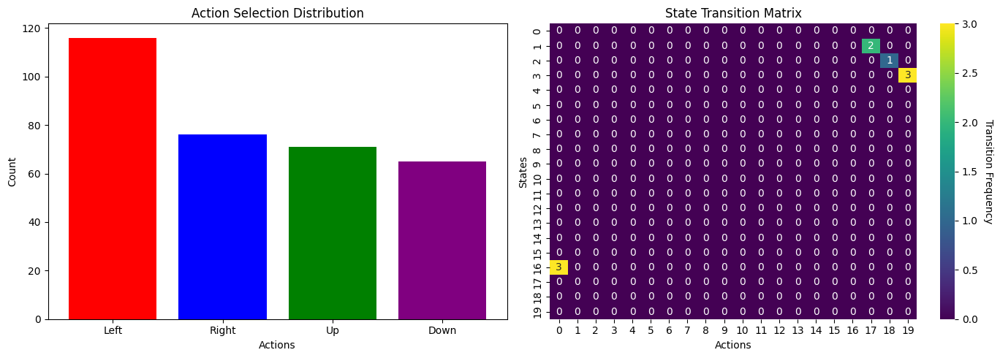

In [42]:
# ================================
# 📊 Testing Visualizations 
# ================================

#  Limit the number of episodes to reduce data size
action_counts_limited = action_counts[:1000]  # Use only the first 1000 episodes for speed
# Limit the state transition matrix and action counts for faster processing
state_transitions_reduced = state_transitions[:20, :20]  # Taking a 20x20 subset of state transitions
action_counts_reduced = action_counts[:4]  # Limit to the first 4 actions

fig, axes = plt.subplots(1, 2, figsize=(14, 5))

# 1️⃣ Action Distribution (with reduced counts)
axes[0].bar(["Left", "Right", "Up", "Down"], action_counts_reduced, color=['red', 'blue', 'green', 'purple'])
axes[0].set_title("Action Selection Distribution")
axes[0].set_xlabel("Actions")  # Label for x-axis (Action type)
axes[0].set_ylabel("Count")    # Label for y-axis (Frequency of actions)

# 2️⃣ State Transition Matrix (with reduced data)
sns.heatmap(state_transitions_reduced, annot=True, cmap="viridis", ax=axes[1])
axes[1].set_title("State Transition Matrix")
axes[1].set_xlabel("Actions")  # Label for x-axis (Action taken from each state)
axes[1].set_ylabel("States")   # Label for y-axis (States of the agent)

# Adding a color bar label for the heatmap
cbar = axes[1].collections[0].colorbar
cbar.set_label('Transition Frequency', rotation=270, labelpad=15)  # Label for the color bar

plt.tight_layout()
plt.show()


### 8.3 Render and Visualize Test Episodes
   - Visualize the test episodes using Matplotlib and animate the agent’s actions during the test.


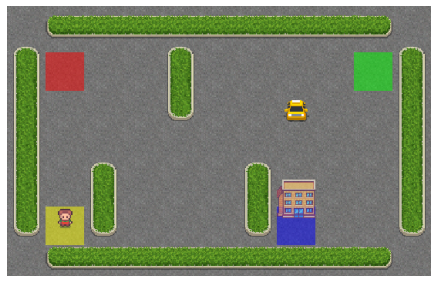

In [27]:
# Visualize the collected frames from the test episodes
dpi = 72
interval = 50  # ms

# Plot the images
plt.figure(figsize=(img[0].shape[1] / dpi, img[0].shape[0] / dpi), dpi=dpi)
patch = plt.imshow(img[0])

# Correct way to hide axes
plt.gca().axis('off')  # Use plt.gca().axis('off') to properly disable axes

# Animate the frames using FuncAnimation
def animate(i):
    patch.set_data(img[i])

ani = animation.FuncAnimation(plt.gcf(), animate, frames=len(img), interval=interval)
display.display(display.HTML(ani.to_jshtml()))


### 9. Animation of Agent's Journey (Visualization Phase)
   - Display the agent’s performance in an animated visualization of the test episodes.


In [28]:
# Animate the agent's journey (already covered above)


### 10. Final Steps
####  Evaluation between Training and Testing 
   


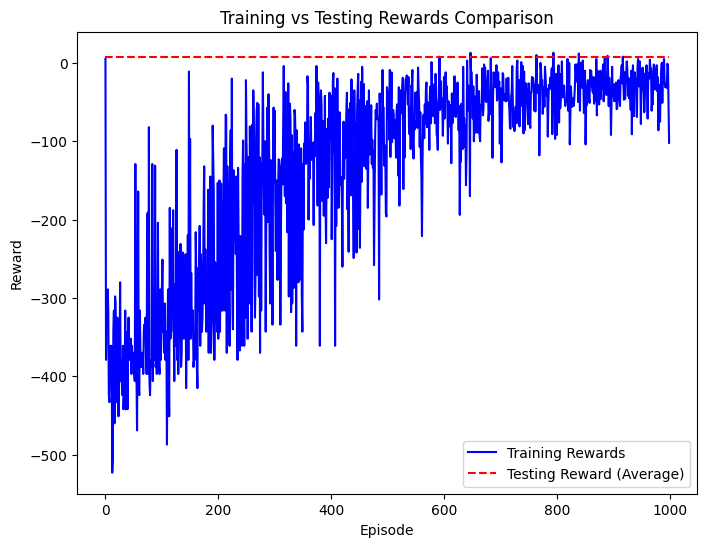

In [44]:
# Simulate rewards during training and testing
training_rewards = rewards_all_episodes[:1000]  # Assuming 1000 training episodes
testing_rewards = []

# Simulate a few testing episodes
for episode in range(30):
    state, _ = env.reset()
    done = False
    episode_reward = 0
    while not done:
        action = np.argmax(q_table[state, :])  # Use trained policy
        state, reward, done, truncated, info = env.step(action)
        episode_reward += reward
    testing_rewards.append(episode_reward)

# Plot comparison
plt.figure(figsize=(8, 6))
plt.plot(training_rewards, label="Training Rewards", color='blue')
plt.plot([np.mean(testing_rewards)] * len(training_rewards), label="Testing Reward (Average)", color='red', linestyle='dashed')
plt.title("Training vs Testing Rewards Comparison")
plt.xlabel("Episode")
plt.ylabel("Reward")
plt.legend()
plt.grid(False)
plt.show()


- Close the environment and display final results after completing all episodes.

In [ ]:
# Close the environment after all episodes
env.close()

### 📝 Conclusion

##### This project successfully demonstrates how reinforcement learning can be applied to real-world decision-making problems. By implementing Q-learning in the Taxi-v3 environment, we observe how the agent improves its performance through iterations. The integration of dynamic obstacles and multi-agent coordination introduces valuable complexity, preparing the model for real-world applications in autonomous systems.
